In [15]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
from PIL import Image

In [16]:
data = "r01"

image_path         = rf"D:\3d-reconstruction\MoGe\output\{data}\image.jpg"
mask_path          = rf"D:\3d-reconstruction\poc-ai-easy-exterior\server\data\{data}\binary_mask.png"

faces_path         = rf"D:\3d-reconstruction\poc-ai-easy-exterior\server\data\{data}\faces.npy"
vertices_path      = rf"D:\3d-reconstruction\poc-ai-easy-exterior\server\data\{data}\vertices.npy"
vertex_colors_path = rf"D:\3d-reconstruction\poc-ai-easy-exterior\server\data\{data}\vertex_colors.npy"
uv_path            = rf"D:\3d-reconstruction\poc-ai-easy-exterior\server\data\{data}\vertex_uvs.npy"

In [17]:
image = cv2.cvtColor(cv2.imread(str(image_path)), cv2.COLOR_BGR2RGB)
height, width = image.shape[:2]
image.shape

(400, 711, 3)

In [18]:
faces         = np.load(faces_path)
vertices      = np.load(vertices_path)
vertex_colors = np.load(vertex_colors_path)
vertex_uvs    = np.load(uv_path)

print(faces.shape)
print(vertices.shape)
print(vertex_colors.shape)
print(vertex_uvs.shape)

FileNotFoundError: [Errno 2] No such file or directory: 'D:\\3d-reconstruction\\poc-ai-easy-exterior\\server\\data\\r01\\vertex_colors.npy'

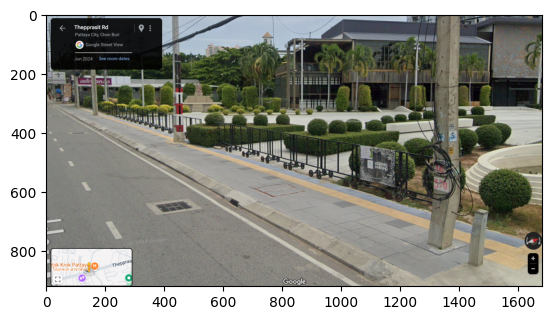

In [ ]:
vertex_colors_img = vertex_colors.reshape(image.shape[0],image.shape[1],3)
plt.imshow(vertex_colors_img)

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]


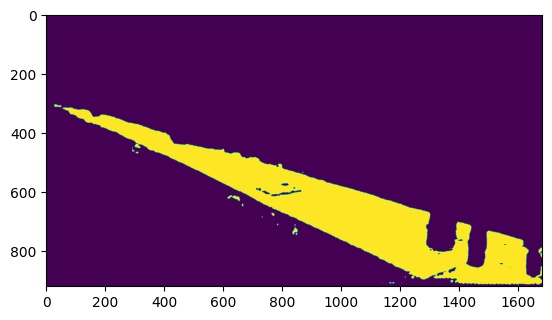

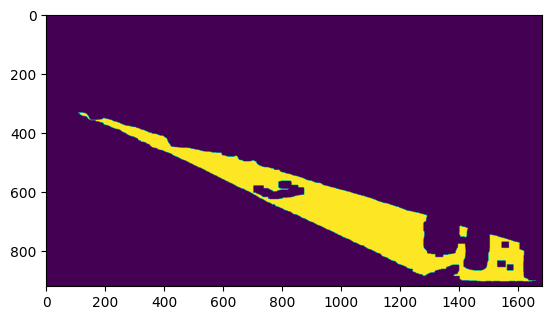

(1548360, 1)


array([      0,       1,       2, ..., 1548357, 1548358, 1548359])

In [ ]:
mask = cv2.imread(mask_path, cv2.IMREAD_GRAYSCALE)
print(mask) # 0/255

mask[mask==255] = 1
print(mask)

plt.imshow(mask)
plt.show()

# Erode mask to help remove potential outliers at the border of the plane
# Define a structuring element (kernel) for erosion
kernel = np.ones((20, 20), dtype=np.uint8)  # 3x3 square kernel
# Apply erosion
eroded_mask = cv2.erode(mask, kernel, iterations=1)
plt.imshow(eroded_mask)
plt.show()

mask = eroded_mask


mask = mask.reshape(-1,1)
print(mask.shape)

idx_to_remove = np.where(mask==0)[0]
idx_to_remove

In [ ]:
# Step 1: Create a mask for vertices to keep
mask = np.ones(len(vertices), dtype=bool)
mask[idx_to_remove] = False

# Step 2: Filter out faces referencing deleted vertices
valid_faces_mask = ~np.any(np.isin(faces, idx_to_remove), axis=1)
filtered_faces = faces[valid_faces_mask]

# Step 3: Create a mapping for reindexing the vertices
new_vertex_indices = np.cumsum(mask) - 1  # Map old indices to new ones
filtered_faces = new_vertex_indices[filtered_faces]

# Step 4: Filter the vertices
filtered_vertices      = vertices[mask]
filtered_vertex_colors = vertex_colors[mask]
filtered_vertex_uvs    = vertex_uvs[mask]

# Result
print("Filtered Vertices:", filtered_vertices.shape)
print("Filtered filtered_vertex_colors:", filtered_vertex_colors.shape)
print("Filtered Vertex UV:", filtered_vertex_uvs.shape)
print("Filtered Faces:", filtered_faces.shape)


Filtered Vertices: (140273, 3)
Filtered filtered_vertex_colors: (140273, 3)
Filtered Vertex UV: (140273, 2)
Filtered Faces: (273679, 3)


In [ ]:
np.save(rf"D:\3d-reconstruction\MoGe\output\{data}\filtered_vertex.npy", filtered_vertices)

In [ ]:
import trimesh
import trimesh.visual

trimesh.Trimesh(
    vertices=filtered_vertices, 
    faces=filtered_faces, 
    visual = trimesh.visual.texture.TextureVisuals(
        uv=filtered_vertex_uvs, 
        material=trimesh.visual.material.PBRMaterial(
            baseColorTexture=Image.fromarray(image),
            metallicFactor=0.5,
            roughnessFactor=1.0
        )
    ),
    process=False
).export(rf"D:\3d-reconstruction\MoGe\output\{data}\masked_mesh.glb")

# trimesh.Trimesh(
#     vertices=filtered_vertices, 
#     faces=filtered_faces, 
#     vertex_colors=filtered_vertex_colors,
#     process=False
# ).export(rf"D:\3d-reconstruction\MoGe\output\{data}\masked_mesh.ply")

b'glTF\x02\x00\x00\x00\xf8\xe8|\x00\x18\x05\x00\x00JSON{"scene":0,"scenes":[{"nodes":[0]}],"asset":{"version":"2.0","generator":"https://github.com/mikedh/trimesh"},"accessors":[{"componentType":5125,"type":"SCALAR","bufferView":0,"count":821037,"max":[140272],"min":[1006]},{"componentType":5126,"type":"VEC3","byteOffset":0,"bufferView":1,"count":140273,"max":[0.3604264557361603,0.44590428471565247,-0.558721661567688],"min":[-2.5830025672912598,-0.1672976016998291,-5.250271797180176]},{"componentType":5126,"type":"VEC2","byteOffset":0,"bufferView":3,"count":140273,"max":[0.9878193736076355,0.9820652008056641],"min":[0.06506238877773285,0.36250001192092896]}],"meshes":[{"name":"geometry_0","extras":{},"primitives":[{"attributes":{"POSITION":1,"TEXCOORD_0":2},"indices":0,"mode":4,"material":0}]}],"images":[{"bufferView":2,"mimeType":"image/png"}],"textures":[{"source":0}],"materials":[{"pbrMetallicRoughness":{"baseColorTexture":{"index":0},"roughnessFactor":1.0,"metallicFactor":0.5},"dou

In [ ]:
import numpy as np

def compute_plane_properties(vertices, faces):
    """
    Compute the position (centroid) and normal vector of a plane defined by multiple faces.
    
    Parameters:
    - vertices: (N, 3) array of vertex positions
    - faces: (M, 3) array of indices of vertices forming each triangular face
    
    Returns:
    - centroid: (3,) array representing the center point of the plane
    - normal: (3,) unit vector representing the normal of the plane
    """
    # Step 1: Compute centroid (average of all vertices in the faces)
    unique_vertex_indices = np.unique(faces.flatten())  # Get unique vertex indices used in the faces
    plane_vertices = vertices[unique_vertex_indices]
    centroid = np.mean(plane_vertices, axis=0)
    
    # Step 2: Compute face normals
    v0 = vertices[faces[:, 0]]
    v1 = vertices[faces[:, 1]]
    v2 = vertices[faces[:, 2]]

    # Compute two edges
    edge1 = v1 - v0
    edge2 = v2 - v0

    # Compute cross product (face normal)
    face_normals = np.cross(edge1, edge2)
    
    # Normalize each face normal
    norms = np.linalg.norm(face_normals, axis=1, keepdims=True)
    face_normals = face_normals / norms  # Avoid division by zero for degenerate triangles
    
    # Step 3: Compute average normal
    average_normal = np.mean(face_normals, axis=0)
    normal = average_normal / np.linalg.norm(average_normal)  # Normalize to unit vector

    return centroid, normal

centroid, normal = compute_plane_properties(filtered_vertices, filtered_faces)


print("PYTHON", "X =", centroid[0],  "Y =", centroid[1],  "Z =", centroid[2])
print("BLENDER", "X =", centroid[0],  "Y =", -centroid[2],  "Z =",centroid[1])

# PYTHON X = -0.06529064737648489 Y = -0.20784762088748943 Z = -1.363950545506098
# BLENDER X = -0.06529064737648489 Y = 1.363950545506098 Z = -0.20784762088748943

PYTHON X = 0.03350663075334694 Y = -0.1085674146572513 Z = -0.9886693195598338
BLENDER X = 0.03350663075334694 Y = 0.9886693195598338 Z = -0.1085674146572513


In [ ]:
# blender
import numpy as np


reference_normal=np.array([0, 1, 0])

normal = normal / np.linalg.norm(normal)
    
# Compute the rotation axis (cross product) and angle (dot product)
axis = np.cross(normal, reference_normal)
angle = np.arccos(np.clip(np.dot(normal, reference_normal), -1.0, 1.0))  # Clip for numerical stability

# Handle edge cases where the normal is already aligned
if np.linalg.norm(axis) < 1e-6:  # Small axis magnitude indicates no rotation needed
    euler_angles = np.zeros(3)
else:
    axis = axis / np.linalg.norm(axis)  # Normalize the rotation axis
    rotation = R.from_rotvec(axis * angle)
    euler_angles = rotation.as_euler('xyz', degrees=True)

print("PYTHON", "X =", euler_angles[0],  "Y =",euler_angles[1],  "Z =",euler_angles[2])

print("BLENDER", "X =", -euler_angles[0],  "Y =",euler_angles[2],  "Z =",euler_angles[1])

# PYTHON X = -23.051556556766165 Y = -0.5404007238452608 Z = -2.64959829900513
# BLENDER X = 23.051556556766165 Y = -2.64959829900513 Z = -0.5404007238452608

PYTHON X = -7.576054424707626 Y = 0.014713215604124292 Z = 0.222220021802266
BLENDER X = 7.576054424707626 Y = 0.222220021802266 Z = 0.014713215604124292


In [ ]:
BLENDER X = 7.576054424707626 Y = 0.222220021802266 Z = 0.014713215604124292